In [1]:
# Support for maths
import numpy as np
# Plotting tools
from matplotlib import pyplot as plt
# we use the following for plotting figures in jupyter
%matplotlib inline
# Importing data library
import pandas as pd

import warnings
warnings.filterwarnings('ignore')

# GPy: Gaussian processess libary
import GPy
from IPython.display import display

import datetime

plt.rcParams.update({'font.size': 32})

In [2]:
# Pembacaan File Data Polusi Udara ISPU Excel
DKI1 = pd.read_excel("./Data/Normalization/DATA ISPU - Normalization.xlsx", sheet_name="DKI1")

### PM10

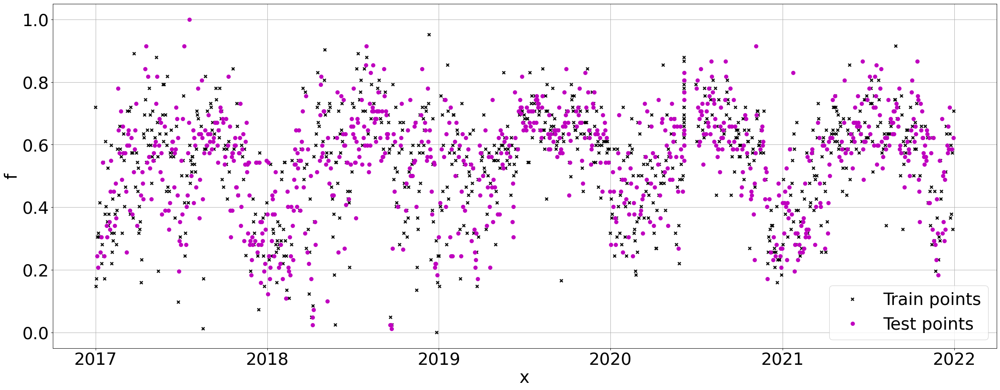

In [81]:
# X = np.array(DKI1.Tanggal.astype('int64') // 10**9)
X = np.array(DKI1.index).reshape(-1,1)
# X = np.array(DKI1['Tanggal']).reshape(-1,1)
Y = np.array(DKI1['PM10']).reshape(-1,1)

from sklearn.model_selection import train_test_split

train_X, test_X, train_Y, test_Y = train_test_split(X, Y, test_size=0.5, random_state=42, shuffle=True)

# Plot observations
plt.figure(figsize=(32, 12), dpi=80)
plt.plot(np.array(DKI1['Tanggal'].loc[train_X.flatten()]).reshape(-1,1), train_Y, "kx", mew=2, label='Train points')
plt.plot(np.array(DKI1['Tanggal'].loc[test_X.flatten()]).reshape(-1,1), test_Y, "mo", mew=2, label='Test points')

# Annotate plot
plt.xlabel("x"), plt.ylabel("f")
plt.grid()
plt.legend()

In [82]:
k1 = GPy.kern.StdPeriodic(1, period=2)
m1 = GPy.models.GPRegression(train_X, train_Y, k1)
m1.optimize(messages=1, ipython_notebook=True)

In [60]:
m1

GP_regression.,value,constraints,priors
std_periodic.variance,0.3167464311029008,+ve,
std_periodic.period,1.9994624140138602,+ve,
std_periodic.lengthscale,1.7310101405715403,+ve,
Gaussian_noise.variance,0.028959950408693997,+ve,


In [61]:
plt.rc('figure', figsize=(64, 24), dpi=240)
m1.plot()
ax = plt.gca()
# ax.plot(train_X, train_Y, color="green", mew=2, label="Train points")
# ax.plot(test_X, test_Y, color="orange", mew=2, label="Test points")
ax.plot(test_X, test_Y, "mo", mew=2, label="Test points")

ax.legend()

In [62]:
from sklearn import metrics

def print_evaluate(true, predicted):  
    mae = metrics.mean_absolute_error(true, predicted)
    mse = metrics.mean_squared_error(true, predicted)
    rmse = np.sqrt(metrics.mean_squared_error(true, predicted))
    r2_square = metrics.r2_score(true, predicted)
    mape = metrics.mean_absolute_percentage_error(true,predicted)
    print('MAE:', mae)
    print('MSE:', mse)
    print('RMSE:', rmse)
    print('MAPE:', mape)

    print('R2 Square', r2_square)
    print('__________________________________')

In [63]:
print('Evaluation:\n_____________________________________')
print_evaluate(test_Y.flatten(), m1.predict(test_X)[0].flatten())

Evaluation:
_____________________________________
MAE: 0.13359322749231334
MSE: 0.02719781522608701
RMSE: 0.16491760132286368
MAPE: 0.44643075007110367
R2 Square 0.018568611715490846
__________________________________


In [84]:
metrics.r2_score(train_Y.flatten(), m1.predict(train_X)[0].flatten())

0.024241868403479416

In [66]:
# Pengambilan Data Forecasting
PM10_Index = np.arange(1826, 1857, dtype=np.int64)
PM10_Index = np.reshape(PM10_Index, (-1, 1))
PM10_Forecasting = m1.predict(PM10_Index)[0].flatten()

In [67]:
# Denormalisasi
max = 86.0
min = 4.0
PM10_Forecasting_denorm = (PM10_Forecasting.flatten() * (max - min) + min)
# PM10_Forecasting_denorm

### SO2

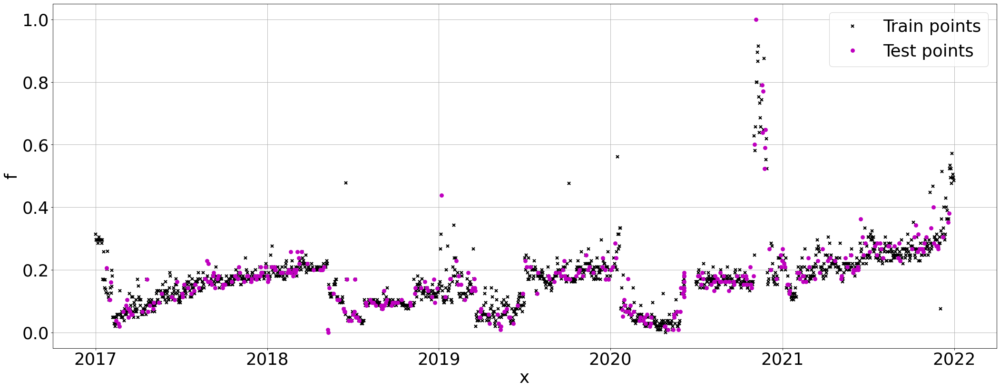

In [68]:
# X = np.array(DKI1.Tanggal.astype('int64') // 10**9)
X = np.array(DKI1.index).reshape(-1,1)
# X = np.array(DKI1['Tanggal']).reshape(-1,1)
Y = np.array(DKI1['SO2']).reshape(-1,1)

from sklearn.model_selection import train_test_split

train_X, test_X, train_Y, test_Y = train_test_split(X, Y, test_size=0.2, random_state=42, shuffle=True)

# Plot observations
plt.figure(figsize=(32, 12), dpi=80)
plt.plot(np.array(DKI1['Tanggal'].loc[train_X.flatten()]).reshape(-1,1), train_Y, "kx", mew=2, label='Train points')
plt.plot(np.array(DKI1['Tanggal'].loc[test_X.flatten()]).reshape(-1,1), test_Y, "mo", mew=2, label='Test points')

# Annotate plot
plt.xlabel("x"), plt.ylabel("f")
plt.grid()
plt.legend()

In [54]:
k2 = GPy.kern.StdPeriodic(1, period=2)
m2 = GPy.models.GPRegression(train_X, train_Y, k2)
m2.optimize(messages=1, ipython_notebook=True)

In [69]:
m2

GP_regression.,value,constraints,priors
std_periodic.variance,1.192595051962092,+ve,
std_periodic.period,1.9989176970881695,+ve,
std_periodic.lengthscale,0.02284575149225009,+ve,
Gaussian_noise.variance,0.0016175156146874163,+ve,


In [70]:
plt.rc('figure', figsize=(64, 24), dpi=240)
m2.plot()
ax = plt.gca()
# ax.plot(train_X, train_Y, color="green", mew=2, label="Train points")
# ax.plot(test_X, test_Y, color="orange", mew=2, label="Test points")
ax.plot(test_X, test_Y, "mo", mew=2, label="Test points")

ax.legend()

In [71]:
print('Evaluation:\n_____________________________________')
print_evaluate(test_Y.flatten(), m2.predict(test_X)[0].flatten())

Evaluation:
_____________________________________
MAE: 0.026258538347558702
MSE: 0.002049823803022029
RMSE: 0.04527497987875897
MAPE: 2238667711619.6494
R2 Square 0.8330760681593455
__________________________________


In [76]:
metrics.r2_score(train_Y.flatten(), m2.predict(train_X)[0].flatten())

0.8710983897635057

In [77]:
# Pengambilan Data Forecasting
SO2_Index = np.arange(1826, 1857, dtype=np.int64)
SO2_Index = np.reshape(SO2_Index, (-1, 1))
SO2_Forecasting = m2.predict(SO2_Index)[0].flatten()

In [78]:
# Denormalisasi
max = 106.0
min = 1.0
SO2_Forecasting_denorm = (SO2_Forecasting.flatten() * (max - min) + min)
# SO2_Forecasting_denorm

### CO

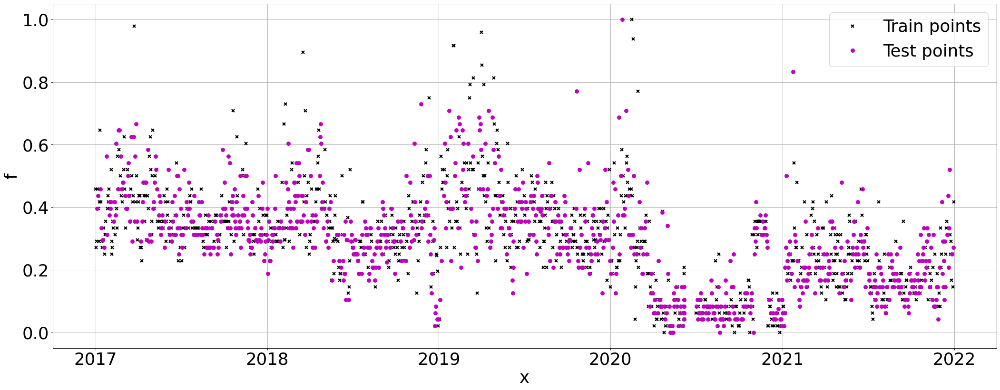

In [85]:
# X = np.array(DKI1.Tanggal.astype('int64') // 10**9)
X = np.array(DKI1.index).reshape(-1,1)
# X = np.array(DKI1['Tanggal']).reshape(-1,1)
Y = np.array(DKI1['CO']).reshape(-1,1)

from sklearn.model_selection import train_test_split

train_X, test_X, train_Y, test_Y = train_test_split(X, Y, test_size=0.5, random_state=42, shuffle=True)

# Plot observations
plt.figure(figsize=(32, 12), dpi=80)
plt.plot(np.array(DKI1['Tanggal'].loc[train_X.flatten()]).reshape(-1,1), train_Y, "kx", mew=2, label='Train points')
plt.plot(np.array(DKI1['Tanggal'].loc[test_X.flatten()]).reshape(-1,1), test_Y, "mo", mew=2, label='Test points')

# Annotate plot
plt.xlabel("x"), plt.ylabel("f")
plt.grid()
plt.legend()

In [86]:
k3 = GPy.kern.StdPeriodic(1, period=2)
m3 = GPy.models.GPRegression(train_X, train_Y, k3)
m3.optimize(messages=1, ipython_notebook=True)

In [87]:
m3

GP_regression.,value,constraints,priors
std_periodic.variance,1.111381591473004,+ve,
std_periodic.period,2.001063154535222,+ve,
std_periodic.lengthscale,0.17867056366493533,+ve,
Gaussian_noise.variance,0.013544330361164163,+ve,


In [88]:
plt.rc('figure', figsize=(64, 24), dpi=240)
m3.plot()
ax = plt.gca()
# ax.plot(train_X, train_Y, color="green", mew=2, label="Train points")
# ax.plot(test_X, test_Y, color="orange", mew=2, label="Test points")
ax.plot(test_X, test_Y, "mo", mew=2, label="Test points")

ax.legend()

In [89]:
print('Evaluation:\n_____________________________________')
print_evaluate(test_Y.flatten(), m3.predict(test_X)[0].flatten())

Evaluation:
_____________________________________
MAE: 0.0787068886579509
MSE: 0.011400835029253183
RMSE: 0.10677469283146257
MAPE: 3026049871819.328
R2 Square 0.48804865312158396
__________________________________


In [90]:
metrics.r2_score(train_Y.flatten(), m3.predict(train_X)[0].flatten())

0.4752544162852448

In [91]:
# Pengambilan Data Forecasting
CO_Index = np.arange(1826, 1857, dtype=np.int64)
CO_Index = np.reshape(CO_Index, (-1, 1))
CO_Forecasting = m2.predict(CO_Index)[0].flatten()

In [92]:
# Denormalisasi
max = 51.0
min = 3.0
CO_Forecasting_denorm = (CO_Forecasting.flatten() * (max - min) + min)
# CO_Forecasting_denorm

### O3

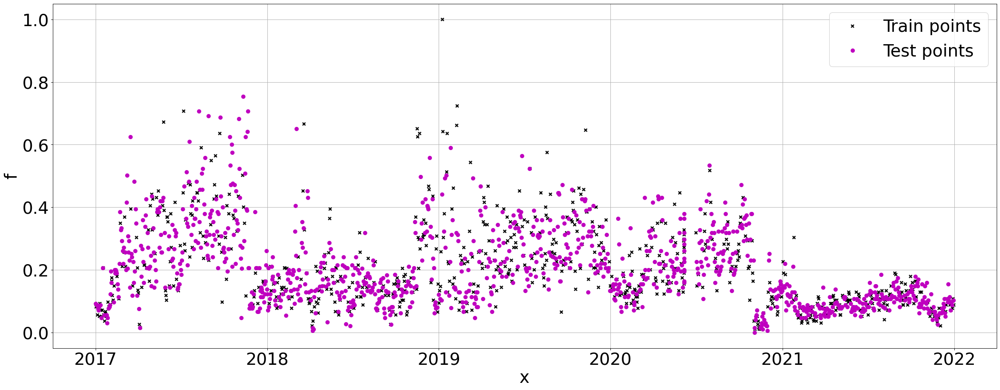

In [95]:
# X = np.array(DKI1.Tanggal.astype('int64') // 10**9)
X = np.array(DKI1.index).reshape(-1,1)
# X = np.array(DKI1['Tanggal']).reshape(-1,1)
Y = np.array(DKI1['O3']).reshape(-1,1)

from sklearn.model_selection import train_test_split

train_X, test_X, train_Y, test_Y = train_test_split(X, Y, test_size=0.6, random_state=42, shuffle=True)

# Plot observations
plt.figure(figsize=(32, 12), dpi=80)
plt.plot(np.array(DKI1['Tanggal'].loc[train_X.flatten()]).reshape(-1,1), train_Y, "kx", mew=2, label='Train points')
plt.plot(np.array(DKI1['Tanggal'].loc[test_X.flatten()]).reshape(-1,1), test_Y, "mo", mew=2, label='Test points')

# Annotate plot
plt.xlabel("x"), plt.ylabel("f")
plt.grid()
plt.legend()

In [96]:
k4 = GPy.kern.StdPeriodic(1, period=2)
m4 = GPy.models.GPRegression(train_X, train_Y, k4)
m4.optimize(messages=1, ipython_notebook=True)

In [97]:
m4

GP_regression.,value,constraints,priors
std_periodic.variance,0.03584462431840043,+ve,
std_periodic.period,1.9989023972964897,+ve,
std_periodic.lengthscale,0.10258161269034434,+ve,
Gaussian_noise.variance,0.01064785225803601,+ve,


In [98]:
plt.rc('figure', figsize=(64, 24), dpi=240)
m4.plot()
ax = plt.gca()
# ax.plot(train_X, train_Y, color="green", mew=2, label="Train points")
# ax.plot(test_X, test_Y, color="orange", mew=2, label="Test points")
ax.plot(test_X, test_Y, "mo", mew=2, label="Test points")

ax.legend()

In [99]:
print('Evaluation:\n_____________________________________')
print_evaluate(test_Y.flatten(), m4.predict(test_X)[0].flatten())

Evaluation:
_____________________________________
MAE: 0.0722707306940594
MSE: 0.009987980783108724
RMSE: 0.09993988584698665
MAPE: 647654354779.6677
R2 Square 0.37204086239640277
__________________________________


In [100]:
metrics.r2_score(train_Y.flatten(), m4.predict(train_X)[0].flatten())

0.4348925481710325

In [101]:
# Pengambilan Data Forecasting
O3_Index = np.arange(1826, 1857, dtype=np.int64)
O3_Index = np.reshape(O3_Index, (-1, 1))
O3_Forecasting = m2.predict(O3_Index)[0].flatten()

In [102]:
# Denormalisasi
max = 198.0
min = 3.0
O3_Forecasting_denorm = (O3_Forecasting.flatten() * (max - min) + min)
# O3_Forecasting_denorm

### NO2

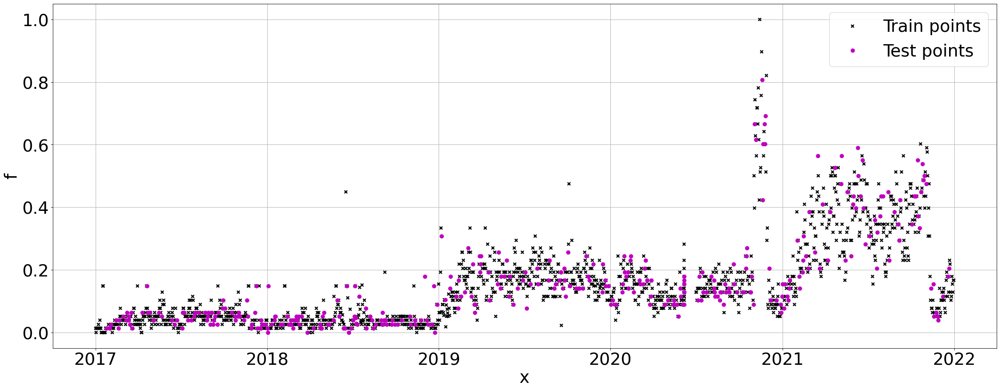

In [105]:
# X = np.array(DKI1.Tanggal.astype('int64') // 10**9)
X = np.array(DKI1.index).reshape(-1,1)
# X = np.array(DKI1['Tanggal']).reshape(-1,1)
Y = np.array(DKI1['NO2']).reshape(-1,1)

from sklearn.model_selection import train_test_split

train_X, test_X, train_Y, test_Y = train_test_split(X, Y, test_size=0.2, random_state=42, shuffle=True)

# Plot observations
plt.figure(figsize=(32, 12), dpi=80)
plt.plot(np.array(DKI1['Tanggal'].loc[train_X.flatten()]).reshape(-1,1), train_Y, "kx", mew=2, label='Train points')
plt.plot(np.array(DKI1['Tanggal'].loc[test_X.flatten()]).reshape(-1,1), test_Y, "mo", mew=2, label='Test points')

# Annotate plot
plt.xlabel("x"), plt.ylabel("f")
plt.grid()
plt.legend()

In [106]:
k5 = GPy.kern.StdPeriodic(1, period=2)
m5 = GPy.models.GPRegression(train_X, train_Y, k5)
m5.optimize(messages=1, ipython_notebook=True)

In [107]:
m5

GP_regression.,value,constraints,priors
std_periodic.variance,0.0022114826547602034,+ve,
std_periodic.period,2.0008099897784706,+ve,
std_periodic.lengthscale,0.20790873834245305,+ve,
Gaussian_noise.variance,0.009492498741247548,+ve,


In [108]:
plt.rc('figure', figsize=(64, 24), dpi=240)
m5.plot()
ax = plt.gca()
# ax.plot(train_X, train_Y, color="green", mew=2, label="Train points")
# ax.plot(test_X, test_Y, color="orange", mew=2, label="Test points")
ax.plot(test_X, test_Y, "mo", mew=2, label="Test points")

ax.legend()

In [109]:
print('Evaluation:\n_____________________________________')
print_evaluate(test_Y.flatten(), m5.predict(test_X)[0].flatten())

Evaluation:
_____________________________________
MAE: 0.061182792926378335
MSE: 0.009500241672972391
RMSE: 0.0974691831963949
MAPE: 2650537873423.455
R2 Square 0.5422596803820199
__________________________________


In [110]:
metrics.r2_score(train_Y.flatten(), m5.predict(train_X)[0].flatten())

0.5697904400204963

In [111]:
# Pengambilan Data Forecasting
NO2_Index = np.arange(1826, 1857, dtype=np.int64)
NO2_Index = np.reshape(NO2_Index, (-1, 1))
NO2_Forecasting = m2.predict(NO2_Index)[0].flatten()

In [112]:
# Denormalisasi
max = 79.0
min = 1.0
NO2_Forecasting_denorm = (NO2_Forecasting.flatten() * (max - min) + min)
# NO2_Forecasting_denorm

### Saving File

In [42]:
start = datetime.datetime.strptime("2022-01-01", "%Y-%m-%d")
date_generated = pd.date_range(start, periods=31)
# print(date_generated.strftime("%Y-%m-%d"))
date_generated

DatetimeIndex(['2022-01-01', '2022-01-02', '2022-01-03', '2022-01-04',
               '2022-01-05', '2022-01-06', '2022-01-07', '2022-01-08',
               '2022-01-09', '2022-01-10', '2022-01-11', '2022-01-12',
               '2022-01-13', '2022-01-14', '2022-01-15', '2022-01-16',
               '2022-01-17', '2022-01-18', '2022-01-19', '2022-01-20',
               '2022-01-21', '2022-01-22', '2022-01-23', '2022-01-24',
               '2022-01-25', '2022-01-26', '2022-01-27', '2022-01-28',
               '2022-01-29', '2022-01-30', '2022-01-31'],
              dtype='datetime64[ns]', freq='D')

In [113]:
d = {"Tanggal":date_generated, "PM10":PM10_Forecasting_denorm, "SO2":SO2_Forecasting_denorm, "CO":CO_Forecasting_denorm, "O3":O3_Forecasting_denorm, "NO2":NO2_Forecasting_denorm}
DKI1_Forecasting = pd.DataFrame(d)
DKI1_Forecasting

,Tanggal,PM10,SO2,CO,O3,NO2
0,2022-01-01,49.763378,51.906165,26.271390,97.540021,38.816008
1,2022-01-02,48.756050,57.018430,28.608425,107.034227,42.613691
2,2022-01-03,49.756144,51.677727,26.166961,97.115778,38.646311
3,2022-01-04,48.749643,56.261323,28.262319,105.628171,42.051268
4,2022-01-05,49.748880,51.096587,25.901297,96.036520,38.214608
5,2022-01-06,48.743209,54.978923,27.676079,103.246572,41.098629
6,2022-01-07,49.741587,50.176003,25.480458,94.326863,37.530745
7,2022-01-08,48.736749,53.251859,26.886564,100.039166,39.815667
8,2022-01-09,49.734265,48.944000,24.917257,92.038857,36.615543
9,2022-01-10,48.730263,51.175731,25.937477,96.183500,38.273400


In [114]:
# Penyimpanan Data Forecasting
DKI1_Forecasting.to_excel('./Data/Forecasting/DKI1_Forecasting.xlsx', index=False)